Margherita Barbuti, ID: 907357 \
Giulia Camilla Denti, ID: 845053

#Introduction

## Import libraries

In [1]:
pip install torchmetrics -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 728.8/728.8 kB 11.3 MB/s eta 0:00:00


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
import glob
from PIL import Image
import PIL
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
import scipy
import os
from sklearn.model_selection import train_test_split
from sklearn.cluster import MiniBatchKMeans
import cv2
import pickle as pkl

from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, ConfusionMatrixDisplay, precision_score, recall_score
from sklearn.neighbors import KNeighborsClassifier

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim.lr_scheduler import CosineAnnealingLR
from torchvision.transforms import InterpolationMode

import torchvision
import torchmetrics
from torchmetrics import Accuracy

import shutil
from torch.utils.tensorboard import SummaryWriter
from tqdm.notebook import tqdm_notebook

from collections import OrderedDict

In [3]:
!gdown "1GwZ9LG5TAi--TwyN6VN4uoeGScRxBXMh"
!unzip -q -n "/content/TinyImageNet.zip"

Downloading...
From: https://drive.google.com/uc?id=1GwZ9LG5TAi--TwyN6VN4uoeGScRxBXMh
To: /content/TinyImageNet.zip
100% 433M/433M [00:06<00:00, 64.6MB/s]


## Mount drive and check GPU

In [4]:
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

%ls

#Directory to drive folders
drive_dir= '/content/drive/My Drive/Supervised Learning/Big Project/'

Mounted at /content/drive/
drive/  sample_data/  TinyImageNet/  TinyImageNet.zip


In [9]:
train_on_gpu = torch.cuda.is_available()
if not train_on_gpu:
    print('CUDA is not available.  Training on CPU ...')
else:
    print('CUDA is available!  Training on GPU ...')
device = torch.device("cuda:0" if train_on_gpu else "cpu")
print(device)

CUDA is not available.  Training on CPU ...
cpu


# Data preprocessing

## Data Loading

Remove greyscale pictures from directory list

In [5]:
create_df = False

if create_df:

  # Open txt files and readlines() to have two lists of lines
  filename_train = "/content/TinyImageNet/train.txt"
  filename_test = "/content/TinyImageNet/val.txt"

  #Create a dictionary to store paths and labels of the files
  data_train = {"Path": [], "Label": []}
  data_test = {"Path": [], "Label": []}

  #Create a dataframe for training images with paths and labels
  with open(filename_train, 'r') as f_train:
    for line in f_train.readlines():
      path, label = np.array(line.split())
      data_train['Path'] += [path]
      data_train['Label'] += [label]
  f_train.close()

  data_train = pd.DataFrame(data_train)

  #Create a dataframe for test images with paths and labels
  with open(filename_test, 'r') as f_test:
    for line in f_test.readlines():
      path, label = np.array(line.split())
      data_test['Path'] += [path]
      data_test['Label'] += [label]

  f_test.close()

  data_test = pd.DataFrame(data_test)


  # Create a list containing only RGB pictures and drop them from dataframe
  #--- Train images
  #Count variable
  non_rgb_train = 0
  #Remove images that do not have 3 channels (not rgb)
  for i in range(len(data_train)):
    im= Image.open(f'/content/TinyImageNet/{data_train["Path"][i]}').getbands()
    if len(im)!=3:
      non_rgb_train += 1
      data_train.drop(i, axis = 0, inplace = True)

  #--- Test images
  #Count variable
  non_rgb_test = 0
  for i in range(len(data_test)):
    im=Image.open(f'/content/TinyImageNet/{data_test["Path"][i]}').getbands()
    if len(im)!=3:
      non_rgb_test += 1
      data_test.drop(i, axis = 0, inplace = True)

  print('Number of non-RGB images in train set: %i' % non_rgb_train)
  print('Number of non-RGB images in test set: %i' % non_rgb_test)

  data_train.to_csv(f'{drive_dir}Data/train_dataset.csv', index = False)
  data_test.to_csv(f'{drive_dir}Data/test_dataset.csv', index = False)

else:
  !gdown -q '1-9FpUZOxlzkPsXri2FqA52Yz9UovJaFp'
  !gdown -q '1-2KjLhj2FN6wqM9zgMRot7n-t53VO1s7'

  data_train_or = pd.read_csv('/content/train_dataset.csv')
  data_test = pd.read_csv('/content/test_dataset.csv')

**Split train data lists into training and validation sets**

In [6]:
#Function to do stratified sampling into training and validation set
#Train size = 70%, test size = 30%
def strat_sampling(df):
  labels = np.unique(df['Label'])

  #Create train and val dataframes
  df_train = pd.DataFrame(columns = ['Path','Label'])
  df_val = df_train = pd.DataFrame(columns = ['Path','Label'])

  #For each subset of data with same label split data into 70% train set and 30% validation set
  for lab in labels:
    df_lab = df.loc[df['Label'] == lab]
    df_lab_train, df_lab_val = train_test_split(df_lab, test_size = 0.3, random_state = 42)
    df_train = pd.concat([df_train,df_lab_train])
    df_val = pd.concat([df_val,df_lab_val])

  #Shuffle dataframes
  df_train = df_train.sample(frac = 1, axis = 0, ignore_index = True, random_state = 42)
  df_val = df_val.sample(frac = 1, axis = 0, ignore_index = True, random_state = 42)

  return df_train, df_val

#Split original train data into train and validation
data_train, data_val = strat_sampling(data_train_or)

data_test = data_test.sample(frac = 1, axis = 0, ignore_index = True, random_state = 42)

### Sample images from each class/label

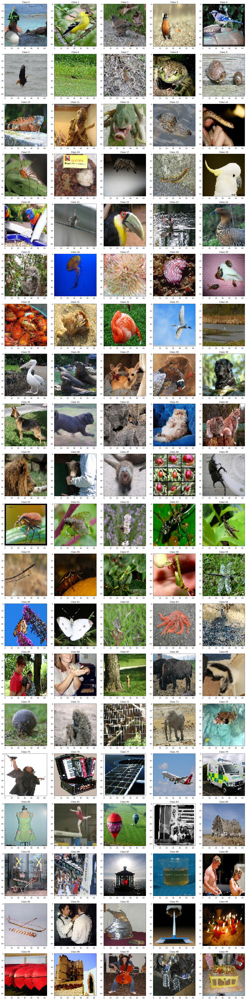

In [ ]:
fig = plt.subplots(20,5, figsize = (20,80))
n = 1
for i in range(0,100):
  subset_lab = data_train.loc[data_train['Label']==i]
  img = Image.open(f'/content/TinyImageNet/{subset_lab["Path"].iloc[2]}')

  plt.subplot(20,5,n)
  plt.imshow(img)
  plt.title('Class %i' %i)

  n+=1

plt.tight_layout()
plt.show()

# Part 2. SIFT, BOW, Classification

##SIFT

**Sample image**

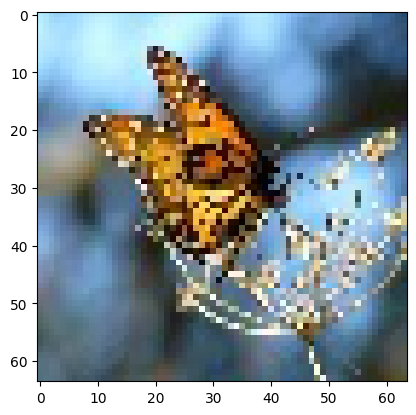

In [ ]:
img_150 = Image.open(f'/content/TinyImageNet/{data_train["Path"].iloc[150]}')

plt.imshow(img_150)

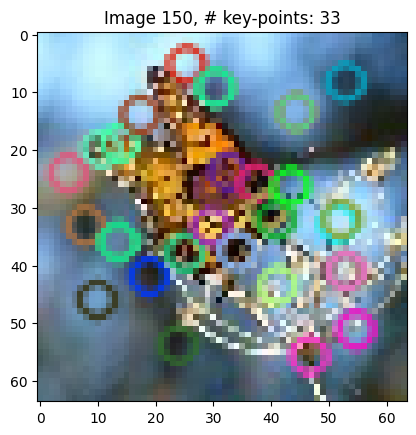

In [ ]:
from cv2 import SIFT
# load image
img = np.array(Image.open(f'/content/TinyImageNet/{data_train["Path"][150]}'))
# create the SIFT object detector
sift = cv2.SIFT_create()

# Compute key-points and descriptor for the image
kp, des= sift.detectAndCompute(img, None)
# Draw the key-points
img_kp = cv2.drawKeypoints(img, kp, img)

plt.imshow(img_kp)
plt.title(f'Image 150, # key-points: {len(kp)}')
plt.show()

**Extract image keypoints and descriptors with SIFT**

In [ ]:
#---Function to find keypoints--
# takes as input
# df = dataset with columns: 'Path' and 'Label'
# It can be specified type of dataset for saving lists (if 'train' a list with all descriptors not divided by image is created)
# It can be specified whether to save or not the image descriptors externally

# Returns:
# image_des = list of list of the descriptor of each image
# desc_tot = list of every keypoints found
# labels_nokp = list of the images without any keypoint

def create_descriptors(df, df_type = 'train', save = True):
  #Create a list to store all descriptors (for each keypoint of all images)
  desc_tot = []
  #List to store descriptors divided by image
  image_des = []
  #List to store labels of images with no keypoints
  labels_nokp = []

  for i in range(len(df)):
    #read image
    img = np.array(Image.open(f'/content/TinyImageNet/{df["Path"].iloc[i]}'))

    #create SIFT
    sift = cv2.SIFT_create()

    #Detect keypoints as descriptors
    kp, des= sift.detectAndCompute(img, None)


    if len(kp) != 0:
      #Append descriptors of each image as an element to use for bag of words
      image_des.append(des)

      if df_type == 'train':
        #Append each keypoint's descriptors to the list (not separated by image) to use for clustering
        for d in des:
          desc_tot.append(d)

    #If an image has no keypoints record its label
    else:
     labels_nokp.append(df["Label"].iloc[i])

  #Save descriptors per image externally
  if save:
    with open(f'{drive_dir}Data/SIFT/image_descriptors_{df_type}.pkl', 'wb') as f:
      pkl.dump(image_des, f)

    with open(f'{drive_dir}Data/SIFT/nokeypoints_{df_type}.pkl', 'wb') as f:
      pkl.dump(labels_nokp, f)

  return image_des, desc_tot, labels_nokp

In [ ]:
create_descr = False

if create_descr:
  # Calls to the function create_descriptors
  # train images
  train_images, train_desc, train_nokp = create_descriptors(data_train)
  # test images
  test_images, _, test_nokp = create_descriptors(data_test, df_type= 'test')
  # validation images
  val_images, _ , val_nokp = create_descriptors(data_val, df_type = 'val')

  # Save all train key-points descriptors on a file
  with open(f'{drive_dir}Data/SIFT/keypoints_descriptors_train.pkl', 'wb') as f:
    pkl.dump(train_desc, f)


# Load the precomputed keypoints descriptors for all images
if create_descr == False:
  #train (images and all descriptors)
  !gdown -q '1Vm6iqb8dmeaP3o_QbPwSomzowMA08Zp_'
  !gdown -q '1-3nj4fdB5v9w_l2rfUHzKZ_6S-8gPbg8'
  !gdown -q '1vhcNYk1KE0ZXOw4uHarOxEbegMdF4DiV'

  with open('/content/image_descriptors_train.pkl', 'rb') as f:
    train_images = pkl.load(f)

  with open('/content/keypoints_descriptors_train.pkl', 'rb') as f:
    train_desc = pkl.load(f)

  with open('/content/nokeypoints_train.pkl', 'rb') as f:
    train_nokp = pkl.load(f)

  #test (only images)
  !gdown -q '1-4K5tsQYVesiMwQ_-P9LKBDbwWOu6AHm'
  !gdown -q '1-2WNPj_iaXJq_6mIzlzx9LMpkyjXycfo'

  with open('/content/image_descriptors_test.pkl', 'rb') as f:
    test_images = pkl.load(f)

  with open('/content/nokeypoints_test.pkl', 'rb') as f:
    test_nokp = pkl.load(f)

  #val (only images)
  !gdown -q '1-GQyK0CXQnQe5ddml3hrrp2XZXAoj5z0'
  !gdown -q '1-5Tt9bRN0eFB4uTpfgQVctqWsgsz1Joe'

  with open('/content/image_descriptors_val.pkl', 'rb') as f:
    val_images = pkl.load(f)

  with open('/content/nokeypoints_val.pkl', 'rb') as f:
    val_nokp = pkl.load(f)

##Bag Of Words

**K-Means++ clustering of descriptors**

In [ ]:
kmeans = False

if kmeans:
  #Define number of clusters (this case 1000)
  k = len(np.unique(data_train['Label']))*10

  batch_size = 1024

  #Implement clustering
  kmeans = MiniBatchKMeans(n_clusters=k, batch_size=batch_size, init='k-means++', n_init=1, max_iter=300, tol=0.0001, verbose=0, random_state=None).fit(train_desc)

**Histograms of Bag of Words**

In [ ]:
#---Function to compute Bag of Word histogram
# inouts:
# image_des = list of list of the keypoints's descriptor of each image
# im_type = train/test/val (used for save the file)
# save = True/False

# Returns:
# histo_list = List of the histogram of each image

def bow_hist(image_des, im_type = 'train', save = True):
  #Create an array to store the histogram of all images
  histo_list = []

  for i in range(len(image_des)):
    # descriptors for each image
    des = image_des[i].astype(float)

    #Predict labels for each image
    pred_labels = kmeans.predict(des)

    #Create a histogram with occurrences of each label for the image, minlength is the number of clusters of kmeans
    hist = np.bincount(pred_labels, minlength = k)

    #Allocate histogram into array of histograms
    histo_list.append(hist)

  if save:
    with open(f'{drive_dir}Data/SIFT/histograms_list_{im_type}.pkl', 'wb') as f:
      pkl.dump(histo_list, f)

  return histo_list

In [ ]:
compute_hist = False

if compute_hist:
  # Call to the bow_hist function
  # Train
  histo_train = bow_hist(train_images)
  # Test
  histo_test = bow_hist(test_images, im_type = 'test')
  # Validation
  histo_val = bow_hist(val_images, im_type = 'val')

# Load precomputed ones
if compute_hist == False:
  !gdown -q '12awVFol-4FDb1mqAuS2cBlFmU-1JzdYg'
  !gdown -q '1-BlLMBZKw_4e86KAhxEwpyBD3BrttCI7'
  !gdown -q '1-DMOFu7E7KHhdMS09wQRkCRTu3ndD2ZY'

  with open('/content/histograms_list_train.pkl', 'rb') as f:
    histo_train = pkl.load(f)

  with open('/content/histograms_list_test.pkl', 'rb') as f:
    histo_test = pkl.load(f)

  with open('/content/histograms_list_val.pkl', 'rb') as f:
    histo_val = pkl.load(f)

**Plot example histogram of a image**

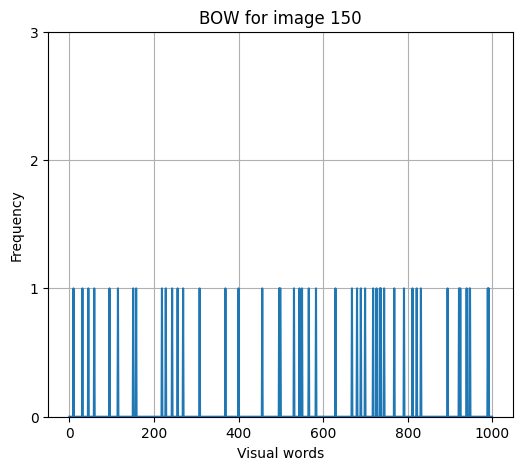

In [ ]:
fig = plt.figure(figsize = (6,5))
plt.plot(histo_train[150])
plt.ylim(0,3)
plt.yticks(range(0,4,1))
plt.xlabel('Visual words')
plt.ylabel('Frequency')
plt.grid()
plt.title(f'BOW for image 150')

plt.show()

## Histogram inspection

In [ ]:
#---Function cout the occurrences of each visual word in the all dataset
# input
# list_histo = list of the histogram of each word

# Returns
# keypoints = list of number of visual words in each image
# total_hist = occurrences of every visual words in all dataset
def histo_dist(list_histo):
  keypoints = np.zeros(len(list_histo))
  #--Add all BOW's to create the distribution of all visual words in the dataset
  #Create a histogram to store all occurrences and sum to it each image's  histogram
  total_hist = np.zeros(1000)
  for i in range(len(list_histo)):
    total_hist += list_histo[i]
    keypoints[i] = np.sum(list_histo[i])

  return keypoints, total_hist

**Distribution of train set**

In [ ]:
# call to histo_dist functions
keypoints_train, total_train = histo_dist(histo_train)

print('Number of images with 0 keypoints: %i' % keypoints_train.count(0))
print('Mean number of keypoints: %i' % np.mean(keypoints_train))
print('Max number of keypoints: %i' % np.max(keypoints_train))
print('Min number of keypoints: %i' % np.min(keypoints_train))

Number of images with 0 keypoints: 61
Mean number of keypoints: 37
Max number of keypoints: 211
Min number of keypoints: 1


**Plot the occurences of all visual words in the train set**

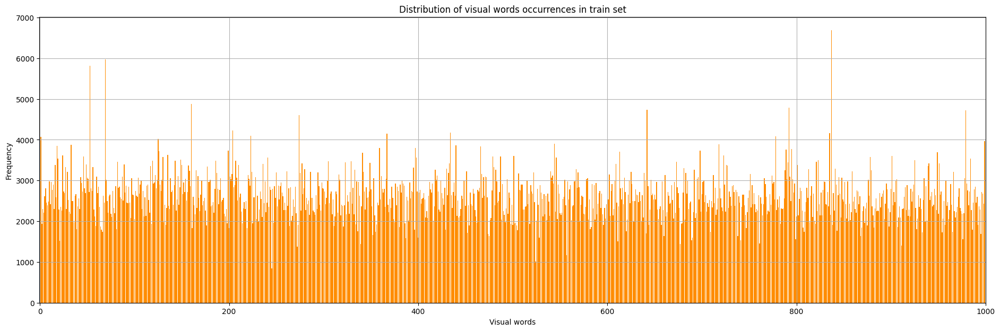

In [ ]:
plt.figure(figsize = (23,7))
plt.bar(range(0,1000), total_train, color = 'darkorange')
plt.xlim(-0.5,1000)
plt.xlabel('Visual words')
plt.ylabel('Frequency')
plt.title('Distribution of visual words occurrences in train set')
plt.grid()
plt.show()

**Distribution of test set**

In [ ]:
keypoints_test, total_test = histo_dist(histo_test)

print('Number of images with 0 keypoints: %i' % keypoints_test.count(0))
print('Mean number of keypoints: %i' % np.mean(keypoints_test))
print('Max number of keypoints: %i' % np.max(keypoints_test))
print('Min number of keypoints: %i' % np.min(keypoints_test))

Number of images with 0 keypoints: 8
Mean number of keypoints: 37
Max number of keypoints: 124
Min number of keypoints: 1


**Plot the occurences of all visual words in the test set**

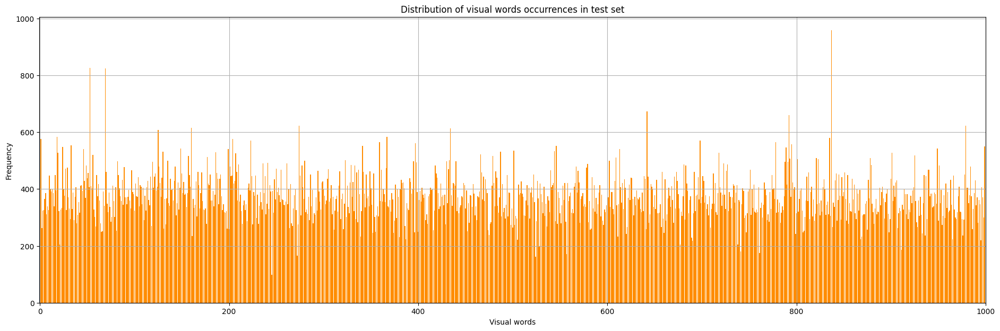

In [ ]:
plt.figure(figsize = (23,7))
plt.bar(range(0,1000), total_test, color = 'darkorange')
plt.xlim(-0.5,1000)
plt.xlabel('Visual words')
plt.ylabel('Frequency')
plt.title('Distribution of visual words occurrences in test set')
plt.grid()
plt.show()

## Classification with SVM

Train a support vector classifier to predict the class of a image from the visual words that describe it

**Process features**

In [ ]:
# Data labels
labels_train = np.array(data_train['Label']).astype(str)
labels_test = np.array(data_test['Label']).astype(str)
labels_val = np.array(data_val['Label']).astype(str)

**Define and train classifier**

In [ ]:
compute_svm= False

if compute_svm:

  #Define SVM
  svc_class = make_pipeline(MinMaxScaler(), SVC(gamma = 'auto'))
  # Train SVM on train set
  svc_class.fit(histo_train, labels_train)
  # Save the trained model
  with open(f'{drive_dir}Data/SIFT/svc.pkl', 'wb') as f:
    pkl.dump(svc_class, f)

# Load the trained model
else:
  !gdown -q '1-EgZO9cVIdt88DIRiNyv2NKW2HfxOdmZ'

  with open('/content/svc.pkl', 'rb') as f:
    svc_class = pkl.load(f)

**Predict classification labels**

In [ ]:
# Prediction on train set
pred_labels_train = svc_class.predict(histo_train)

In [ ]:
# Prediction on test set
pred_labels_test = svc_class.predict(histo_test)

**Accuracy score**

In [ ]:
#--Computes Accuracy per class
# input: list of true and predicted labels
# Returns: a list of accuracies (length 100)
def accuracy_per_class(true_labels, pred_labels):
  # list of the label featured in true_label
  labels = np.unique(true_labels)
  true_labels = np.array(true_labels)
  pred_labels = np.array(pred_labels)
  acc_class = []
  for lab in labels:
    # indeces where the true_label are equal to the courrent lab
    idx = np.argwhere(true_labels == lab)
    # reduce lists of true and predicted labels with idx
    t_lab = true_labels[idx]
    p_lab = pred_labels[idx]
    # Compute accuracy and store it
    acc_class += [accuracy_score(t_lab, p_lab)]

  return acc_class

In [ ]:
# Accuracy function from sklearn library
accuracy_svc_train = accuracy_score(labels_train, pred_labels_train)
accuracy_svc_test = accuracy_score(labels_test, pred_labels_test)

print("SVC accuracy on train set: %.3f" % accuracy_svc_train)
print("SVC accuracy on test set: %.3f" % accuracy_svc_test)

SVC accuracy on train set: 0.081
SVC accuracy on test set: 0.041


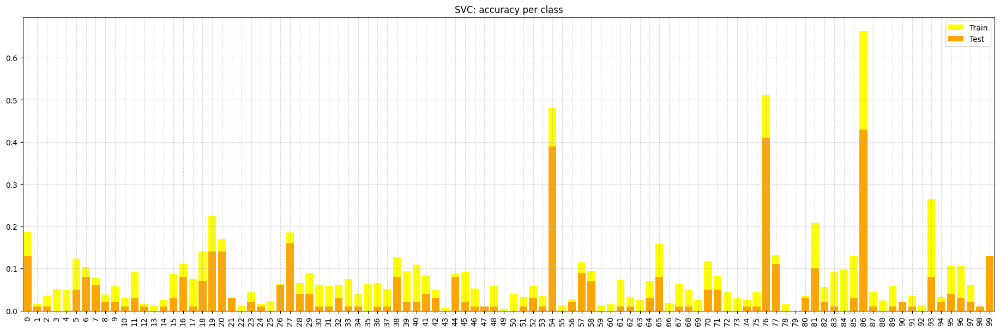

In [ ]:
#Compute the accuracy per class of the SVC
acc_per_class_train = accuracy_per_class(labels_train, pred_labels_train)
acc_per_class_test = accuracy_per_class(labels_test, pred_labels_test)

#Plot of the accuracy per class of the SVC
# yellow on train set, orange on test set
#x-axis = classes, y-axis = accuracy
#blue lines cut at maximum and minimum accuracy

acc_fig = plt.figure(figsize = (23,7))
plt.bar(range(0,100,1), acc_per_class_train, width = 0.8, color = 'yellow', label= 'Train')
plt.bar(range(0,100,1), acc_per_class_test, width = 0.8, color = 'orange', label ='Test')
plt.xticks(range(0,100,1), rotation= 90)
plt.xlim(-0.5,99.5)
plt.xlabel('Class')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(alpha = 0.5, linestyle = '--')
plt.title('SVC: accuracy per class')
plt.show()

## Classification with Random Forest

Train Random Forest to classify the image from the BOW

**Define and train classifier**

In [ ]:
compute_rf= False

if compute_rf:

  #Define SVM
  rf_class = make_pipeline(MinMaxScaler(), RandomForestClassifier(max_depth = 30, bootstrap = True, random_state = 42))
  # train the model
  rf_class.fit(histo_train, labels_train)
  # Save the Model
  with open(f'{drive_dir}Data/SIFT/randomforest.pkl', 'wb') as f:
    pkl.dump(rf_class, f)

# Load the pre-trained model
else:
  !gdown -q '1uZNdnzTmHCPP5f0ps_u8pFBqdpyr1o_g'

  with open('/content/randomforest.pkl', 'rb') as f:
    rf_class = pkl.load(f)

**Predict classification labels**

In [ ]:
pred_labels_train = rf_class.predict(histo_train)

In [ ]:
pred_labels_test = rf_class.predict(histo_test)

**Accuracy score**

In [ ]:
accuracy_rf_train = accuracy_score(labels_train, pred_labels_train)
accuracy_rf_test = accuracy_score(labels_test, pred_labels_test)

print("RF accuracy on train set: %.3f" % accuracy_rf_train)
print("RF accuracy on test set: %.3f" % accuracy_rf_test)

RF accuracy on train set: 0.785
RF accuracy on test set: 0.035


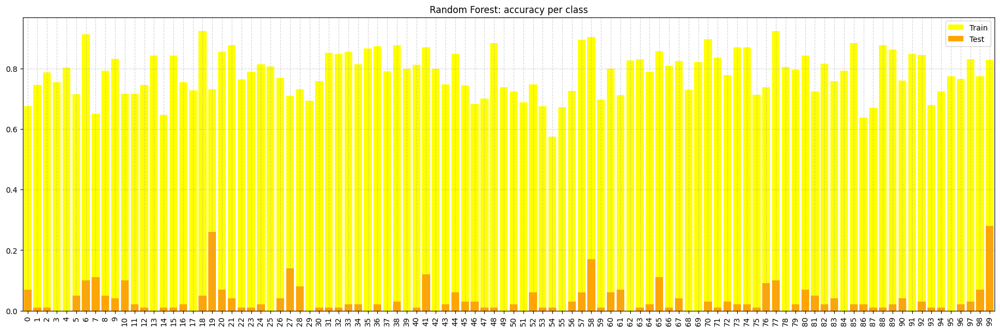

In [ ]:
#Compute the accuracy per class of the RF
acc_per_class_train = accuracy_per_class(labels_train, pred_labels_train)
acc_per_class_test = accuracy_per_class(labels_test, pred_labels_test)

#Plot of the accuracy per class of the RF
# yellow on train set, orange on test set
#x-axis = classes, y-axis = accuracy
#blue lines cut at maximum and minimum accuracy

acc_fig = plt.figure(figsize = (23,7))
plt.bar(range(0,100,1), acc_per_class_train, width = 0.8, color = 'yellow', label= 'Train')
plt.bar(range(0,100,1), acc_per_class_test, width = 0.8, color = 'orange', label ='Test')
plt.xticks(range(0,100,1), rotation= 90)
plt.xlim(-0.5,99.5)
plt.xlabel('Class')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(alpha = 0.5, linestyle = '--')
plt.title('Random Forest: accuracy per class')
plt.show()

## Classification with K-Nearest Neighbors

Train K-Nearest neighbor classifier to classify the image from the BOW

**Define and train classifier**

In [ ]:
compute_knn= True

if compute_knn:

  #Define SVM
  knn_class = make_pipeline(MinMaxScaler(), KNeighborsClassifier(n_neighbors = 6, metric = 'euclidean', n_jobs = -1))
  # Train the model
  knn_class.fit(histo_train, labels_train)

  with open(f'{drive_dir}Data/SIFT/knn.pkl', 'wb') as f:
    pkl.dump(knn_class, f)

# Load pre-trained model
else:
  !gdown -q '1Wgf1XWiMCRS0Zw_4GkDXWBaXF9HealX6'

  with open('/content/knn.pkl', 'rb') as f:
    knn_class = pkl.load(f)

**Predict classification labels**

In [ ]:
pred_labels_train = knn_class.predict(histo_train)

In [ ]:
pred_labels_test = knn_class.predict(histo_test)

**Accuracy score**

In [ ]:
accuracy_knn_train = accuracy_score(labels_train, pred_labels_train)
accuracy_knn_test = accuracy_score(labels_test, pred_labels_test)

print("KNN accuracy on train set: %.3f" % accuracy_knn_train)
print("KNN accuracy on test set: %.3f" % accuracy_knn_test)

KNN accuracy on train set: 0.133
KNN accuracy on test set: 0.016


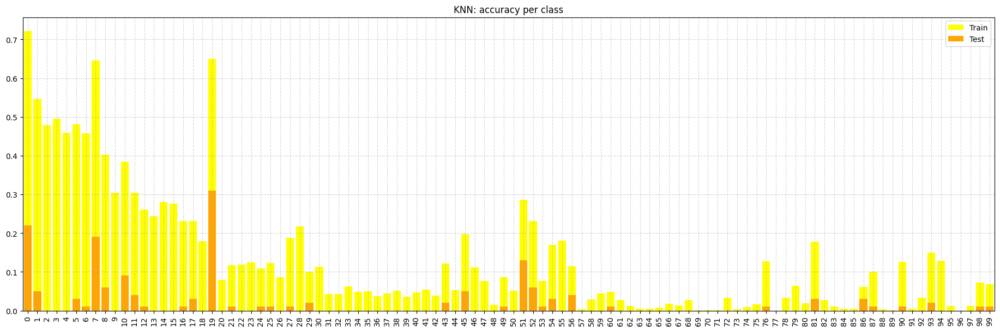

In [ ]:
#Compute the accuracy per class of the SVC
acc_per_class_train = accuracy_per_class(labels_train, pred_labels_train)
acc_per_class_test = accuracy_per_class(labels_test, pred_labels_test)

#Plot of the accuracy per class of the SVC
#x-axis = classes, y-axis = accuracy
#blue lines cut at maximum and minimum accuracy

acc_fig = plt.figure(figsize = (23,7))
plt.bar(range(0,100,1), acc_per_class_train, width = 0.8, color = 'yellow', label= 'Train')
plt.bar(range(0,100,1), acc_per_class_test, width = 0.8, color = 'orange', label ='Test')
plt.xticks(range(0,100,1), rotation= 90)
plt.xlim(-0.5,99.5)
plt.xlabel('Class')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(alpha = 0.5, linestyle = '--')
plt.title('KNN: accuracy per class')
plt.show()

# Part 3. CNN for image classification

Use pre-trained CNN on the ImageNet Dataset to classify the TinyImageNet applying transfer learning, redefining and training the fully connected layers.

Models used:
*   Efficient Net B0
*   Mobile Net V3 large



## Dataset and dataloader

**Dataset class**


In [ ]:
class ImNetDataset(Dataset):
  def __init__(self, df_root, transform =  None):
    """
      root_dir (DataFrame): Directory with all the images and the corresponding labels.
      transform (callable, optional): Optional transform to be applied on a sample.
    """
    self.root = df_root
    self.transform = transform

  def __len__(self):
    return len(self.root)

  def __getitem__(self, idx):
    img_name = self.root["Path"][idx]
    img_label = self.root["Label"][idx]

    image = Image.open(f'/content/TinyImageNet/{img_name}')

    if self.transform != None:
      image = self.transform(image)

    return image, img_label

**Define transforms**

Transform the images to match the transformation applied to the images used to trained the efficient net and mobile net

In [ ]:
# Resize the images to 224x224, normilize it and make it tensor
transform_train = transforms.Compose([
                                      transforms.Resize((256,256), interpolation=InterpolationMode.BICUBIC),
                                      transforms.CenterCrop((224,224)),
                                      transforms.ToTensor(),
                                      transforms.Normalize(
                                      mean=[0.485, 0.456, 0.406],
                                      std=[0.229, 0.224, 0.225]),
                                      ])

transform_val = transforms.Compose([
                                    transforms.Resize((256,256), interpolation=InterpolationMode.BICUBIC),
                                    transforms.CenterCrop((224,224)),
                                    transforms.ToTensor(),
                                    transforms.Normalize(
                                    mean=[0.485, 0.456, 0.406],
                                    std=[0.229, 0.224, 0.225]
                                     )])

**Dataloaders**

3 Dataloaders for training, validation and testing

In [ ]:
# batch size
bs_train = 50
bs_val = 256

trainset = ImNetDataset(data_train, transform = transform_train)
valset = ImNetDataset(data_val, transform = transform_val)
testset = ImNetDataset(data_test, transform = transform_val)

trainloader = torch.utils.data.DataLoader(trainset, batch_size=bs_train,
                                          shuffle=True, num_workers=0)

valloader = torch.utils.data.DataLoader(valset, batch_size=bs_val,
                                         shuffle=False, num_workers=0)

testloader = torch.utils.data.DataLoader(testset, batch_size= 1,
                                         shuffle=False, num_workers=0)

**Visualize images from the Dataset**

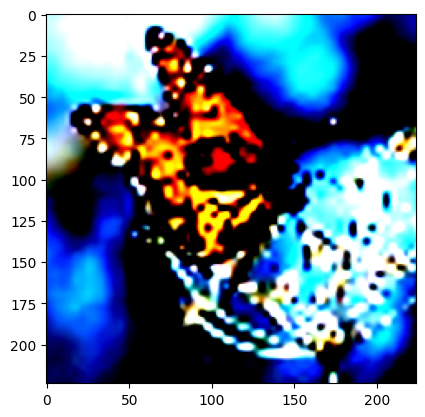

In [ ]:
plt.imshow((trainset.__getitem__(150))[0].permute(1,2,0))

## Useful functions for validation and training

Accuracy function

In [ ]:
#---Function to compute the accuracy
# input:  net = the network to evaluate
#         dataloader = dataloader
#         device = device (cpu or cuda)

# Returns:  accuracy = overall accuracy
#           gt_labels = list of the true labels
#           pred_labels = list of the predicted labels

def compute_acc(net, dataloader, device):
  #Move network to device
  net.to(device)

  #set the network in eval mode
  net.eval()

  # define metric objects
  acc = Accuracy(task = 'multiclass', num_classes = 100)
  #Move accuracy to device
  acc = acc.to(device)

  #Lists to store ground truth labels and predicted labels
  gt_labels = []
  pred_labels = []

  #Progress bar for epochs
  tqdm_val = tqdm_notebook(total=len(dataloader), desc='Validation batch')

  for inp, gt in dataloader:
    #move the batch on the device
    inp = inp.to(device)
    gt = gt.to(device)

    #compute the prediction
    with torch.no_grad():
      out = net(inp)
      #Take the most probable class in the output vector
      _, out = torch.max(out, dim = 1)

    # Add ground truth label and predicted label to list of labels
    gt_labels += gt.tolist()
    pred_labels += out.tolist()

    # update metrics
    acc.update(out, gt.long())

    #update progress bar
    tqdm_val.update(1)

  tqdm_val.close()
  # you can update the metrics with more batches ..
  # at the end, compute the final score
  accuracy = acc.compute()

  net.train()
  return accuracy, gt_labels, pred_labels

Train function

In [ ]:
# Train routine
#input: net = model
#       experiment_name = experiment name to write in the dashboard
#       trainloader = dataloader of the train set
#       valloader = dataloader of the validation set
#       n_epoch = number of epochs

def training(net, experiment_name, trainloader, valloader, n_epoch, device):
  # Move network to the device
  net = net.to(device)
  learning_rate = 0.001

  # define optimizer
  optimizer = torch.optim.Adam(params = net.parameters(), lr = learning_rate)
  # define scheduler of the learning rate
  scheduler = CosineAnnealingLR(optimizer, T_max = len(trainloader)*5, eta_min = 1e-5)

  # define summary writer
  writer = SummaryWriter(experiment_name)

  # Initialize best validation value
  best_val = None

  # Initialize iteration number
  n_iter = 0
  total_batches = len(trainset)//bs_train

  #Progress bar for epochs
  tqdm_epochs = tqdm_notebook(total=n_epoch, desc='Epochs')

  # for each epoch
  for cur_epoch in range(n_epoch):
      # plot current epoch
      writer.add_scalar("epoch", cur_epoch, cur_epoch)

      # Progress bar for batches
      tqdm_batches = tqdm_notebook(total= total_batches, desc=f'Epoch {cur_epoch}')

      # for each batch
      for inp, gt in trainloader:
          # move batch to gpu
          inp = inp.to(device)
          gt = gt.to(device)
          # reset gradients
          optimizer.zero_grad()
          # get output
          out = net(inp)

          # comèute the cross entropy loss
          loss = nn.CrossEntropyLoss()
          loss = loss(out, gt)
          # backpropagation
          loss.backward()

          # update optimizer and scheduler
          optimizer.step()
          scheduler.step()

          # plot current loss
          writer.add_scalar("loss",loss.item(), n_iter)

          #Update progress bar
          tqdm_batches.update(1)
          n_iter += 1

      # at the end of evry epoch validate model
      # Validate the model with accuracy
      acc, _, _ = compute_acc(net, valloader, device)
      # plot accuracy
      writer.add_scalar("accuracy", acc, cur_epoch)
      # check if it is the best model so far (current accuracy major of best value)
      if best_val is None or acc > best_val:
          # define new best val
          best_val = acc
          # save current model as best
          torch.save({
              'model': net.state_dict(),
              'opt': optimizer.state_dict(),
              'epoch': cur_epoch
          }, experiment_name + '_best.pth')

      # save last model
      torch.save({
          'model': net.state_dict(),
          'opt': optimizer.state_dict(),
          'epoch': cur_epoch
      }, experiment_name + '_last.pth')

      tqdm_batches.close()
      tqdm_epochs.update(1)

  tqdm_epochs.close()

## First architecture: EfficientNet_B0

Parameters = 5.3M, Top-1 accuracy = 77.692%

### **Define model**
Transfer learning, fine-tuning, add classifier

In [ ]:
# Load the model with pretrained weights
net_eff = torchvision.models.efficientnet_b0(weights = 'IMAGENET1K_V1')

# Get the number of input of the classifier
num_features = net_eff.classifier[1].in_features

# Redefine the classifier with number of output eqaul to 100
net_eff.classifier = nn.Sequential(nn.Linear(num_features, 704),
                                    nn.ReLU(),
                                    nn.Linear(704, 352),
                                    nn.ReLU(),
                                    nn.Linear(352, 100))

#print(net_eff)

Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-3dd342df.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-3dd342df.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 143MB/s] 


In [ ]:
## Iteration to freeze convolutional layers and only train the fully connected ones
for key, value in dict(net_eff.named_children()).items():
  if 'classifier' in key:
    for param in value.parameters():
        # True if gradients need to be computed for this Tensor
        param.requires_grad = True
  else:
    for param in value.parameters():
        # Freeze the layer
        param.requires_grad = False

In [ ]:
# Test the network
# define random batch of 50 elements
input_size = [50, 3, 224, 224]
inp = torch.rand(input_size)

# forward
out = net_eff(inp)

# let's print the shape
print(' Input shape is', inp.shape)
print('Output shape is', out.shape)

 Input shape is torch.Size([50, 3, 224, 224])
Output shape is torch.Size([50, 100])


### **Train and evaluate model**

In [ ]:
# Tensorboard
train_model = False

if train_model:
  experiment_name = 'Efficient_net_b0_2'
  # %load_ext tensorboard
  %reload_ext tensorboard
  %tensorboard --logdir={experiment_name}

<IPython.core.display.Javascript object>

In [ ]:
# call to training function
if train_model:
  training(net_eff, experiment_name, trainloader, valloader, 7, device)

Epochs:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch 0:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

Epoch 1:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

Epoch 2:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

Epoch 3:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

Epoch 4:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

Epoch 5:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

Epoch 6:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

### **Test model**

In [ ]:
#Import the best model (set load_model = True)
load_model = True

if load_model:
  # define network without the weights
  net_eff = torchvision.models.efficientnet_b0()
  # Redefine the classifier
  num_features = net_eff.classifier[1].in_features

  net_eff.classifier = nn.Sequential(nn.Linear(num_features, 704),
                                      nn.ReLU(),
                                      nn.Linear(704, 352),
                                      nn.ReLU(),
                                      nn.Linear(352, 100))

  # Load the weights
  !gdown -q '1ffl7tDE_T2AtWlZOaRWUWRi0_l5RGLwH'
  checkpoint = torch.load("/content/Efficent_net_b0_2_best.pth", map_location = device)
  net_eff.load_state_dict(checkpoint['model'])
  net_eff.to(device)

In [ ]:
#Compute accuracy on test and train set and extract true and predicted labels
test_acc, gt_lab, pred_lab = compute_acc(net_eff, testloader, device)
train_acc, gt_lab_train, pred_lab_train = compute_acc(net_eff, trainloader, device)

Validation batch:   0%|          | 0/10000 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/1400 [00:00<?, ?it/s]

In [ ]:
print('Accuracy on train set: %.4f' % train_acc)
print('Accuracy on test set: %.4f' % test_acc)

Accuracy on train set: 0.8585
Accuracy on test set: 0.7241


In [ ]:
#Compute the accuracy per class of the EfficientNet
# Call the accuracy_per_class function
acc_per_class = accuracy_per_class(gt_lab, pred_lab)
acc_per_class_train = accuracy_per_class(gt_lab_train, pred_lab_train)

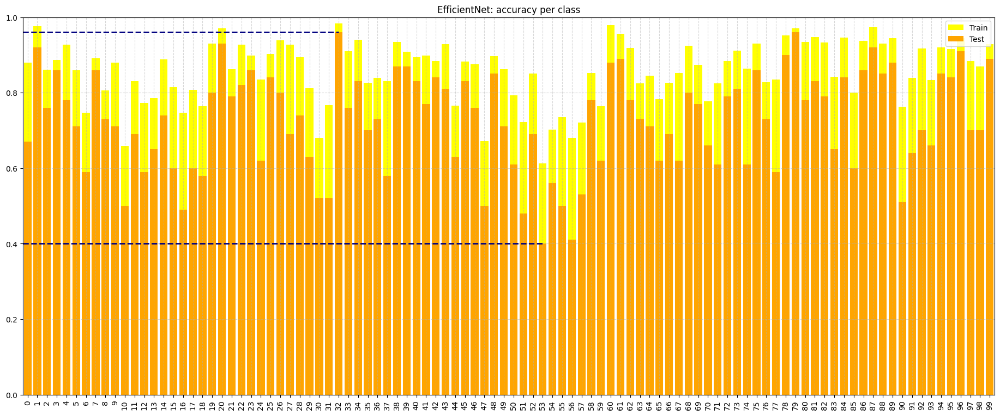

In [ ]:
#Plot of the accuracy per class of the EfficientNet
#x-axis = classes, y-axis = accuracy
#blue lines cut at maximum and minimum accuracy
# yellow train set, orange test set

acc_fig = plt.figure(figsize = (23,9))
plt.bar(range(0,100,1), acc_per_class_train, width = 0.8, color = 'yellow', label = 'Train')
plt.bar(range(0,100,1), acc_per_class, width = 0.8, color = 'orange', label = 'Test')
plt.xticks(range(0,100,1), rotation= 90)
plt.ylim(0,1)
plt.xlim(-0.5,99.5)
plt.xlabel('Class')
plt.ylabel('Accuracy')
plt.axhline(np.min(acc_per_class), xmax = (np.argmin(acc_per_class)+0.5)/100, c = 'navy', linewidth = 2, ls = '--')
plt.axhline(np.max(acc_per_class), xmax = (np.argmax(acc_per_class)+0.5)/100, c = 'navy', linewidth = 2, ls = '--')  #-2 ?? bo
plt.grid(alpha = 0.5, linestyle = '--')
plt.legend(loc = 'upper right')
plt.title('EfficientNet: accuracy per class')
plt.show()

## Second model: MobileNet Large

Parameters=5.5M, Top-1 accuracy=74.042%

### **Define model**
Transfer learning, fine-tuning, add classifier

In [ ]:
# Load the model with pretrained weights
net_mob = torchvision.models.mobilenet_v3_large(weights = 'IMAGENET1K_V1')


# Get the number of input of the classifier
num_features = net_mob.classifier[0].in_features

# Redefine the classifier with number of output eqaul to 100
net_mob.classifier = nn.Sequential(nn.Linear(num_features, 704),
                                  nn.ReLU(),
                                  nn.Linear(704, 352),
                                  nn.ReLU(),
                                  nn.Linear(352, 100))

In [ ]:
## Iteration to freeze first layers and only train the last ones
for key, value in dict(net_mob.named_children()).items():
  if 'classifier' in key:
    for param in value.parameters():
        # True if gradients need to be computed for this Tensor
        param.requires_grad = True
  else:
    for param in value.parameters():
        # Freeze the layer
        param.requires_grad = False

In [ ]:
# Test the network
# define random batch of 50 elements
input_size = [50, 3, 224, 224]
inp = torch.rand(input_size)

# forward
out = net_mob(inp)

# let's print the shape
print(' Input shape is', inp.shape)
print('Output shape is', out.shape)

 Input shape is torch.Size([50, 3, 224, 224])
Output shape is torch.Size([50, 100])


### **Train and evaluate model**

In [ ]:
# Defien tensorboard
train_model = False

if train_model:
  experiment_name = 'mobile_net_large_2'
  # %load_ext tensorboard
  %reload_ext tensorboard
  %tensorboard --logdir={experiment_name}

<IPython.core.display.Javascript object>

In [ ]:
# call to training function
if train_model:
  training(net_mob, experiment_name, trainloader, valloader, 7, device)

Epochs:   0%|          | 0/7 [00:00<?, ?it/s]

Epoch 0:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

Epoch 1:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

Epoch 2:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

Epoch 3:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

Epoch 4:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

Epoch 5:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

Epoch 6:   0%|          | 0/1400 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/118 [00:00<?, ?it/s]

### **Test model**

In [ ]:
#If the model is already trained, import it (set load_model = True)
load_model = True

if load_model:
  # Load the model without weights
  net_mob = torchvision.models.mobilenet_v3_large()

  # Redefine the same architecure
  num_features = net_mob.classifier[0].in_features
  net_mob.classifier = nn.Sequential(nn.Linear(num_features, 704),
                                    nn.ReLU(),
                                    nn.Linear(704, 352),
                                    nn.ReLU(),
                                    nn.Linear(352, 100))

  # Load the weights
  !gdown -q '1XFmUUUtOou3q2kTjXMwKE2bLOEvjtHpf'
  checkpoint = torch.load("/content/mobile_net_large_2_best.pth", map_location = device)
  net_mob.load_state_dict(checkpoint['model'])
  net_mob.to(device)

In [ ]:
#Compute accuracy on test set and extract true and predicted labels
test_acc, gt_lab, pred_lab = compute_acc(net_mob, testloader, device)
train_acc, gt_lab_train, pred_lab_train = compute_acc(net_mob, trainloader, device)

Validation batch:   0%|          | 0/10000 [00:00<?, ?it/s]

Validation batch:   0%|          | 0/1400 [00:00<?, ?it/s]

In [ ]:
print('Accuracy on train set: %.3f' % train_acc)
print('Accuracy on test set: %.3f' % test_acc)

Accuracy on train set: 0.811
Accuracy on test set: 0.712


In [ ]:
#Compute the accuracy per class of the MobileNet
# Calls to the function accuracy_per_class
acc_per_class = accuracy_per_class(gt_lab, pred_lab)
acc_per_class_train = accuracy_per_class(gt_lab_train, pred_lab_train)

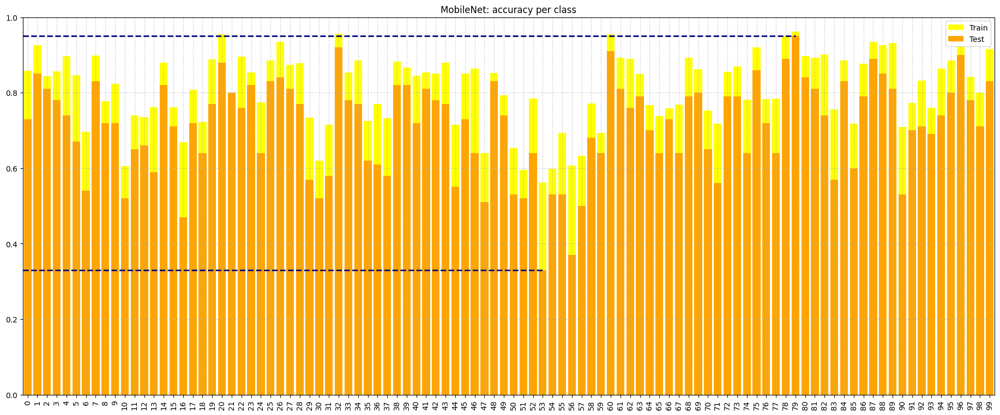

In [ ]:
#Plot of the accuracy per class of the MobileNet
#x-axis = classes, y-axis = accuracy
#blue lines cut at maximum and minimum accuracy
# yellow train set, orange test set

acc_fig = plt.figure(figsize = (23,9))
plt.bar(range(0,100,1), acc_per_class_train, width = 0.8, color = 'yellow', label = 'Train')
plt.bar(range(0,100,1), acc_per_class, width = 0.8, color = 'orange', label = 'Test')
plt.xticks(range(0,100,1), rotation= 90)
plt.ylim(0,1)
plt.xlim(-0.5,99.5)
plt.xlabel('Class')
plt.ylabel('Accuracy')
plt.axhline(np.min(acc_per_class), xmax = (np.argmin(acc_per_class)+0.5)/100, c = 'navy', linewidth = 2, ls = '--')
plt.axhline(np.max(acc_per_class), xmax = (np.argmax(acc_per_class)+0.5)/100, c = 'navy', linewidth = 2, ls = '--')  #-2 ?? bo
plt.grid(alpha = 0.5, linestyle = '--')
plt.legend()
plt.title('MobileNet: accuracy per class')
plt.show()

## Show some sample images and their predicted and true labels

In [ ]:
# Set network to evaluation mode
net_eff.eval()
net_mob.eval()

#Choose 100 random images to classify
indices = np.random.randint(0, len(testset), 100)

#Create lists to store labels
labels_eff = []
labels_mob = []

#Predict labels with both nets and store the lables
for idx in indices:
  test_img, test_label = testset[idx]
  _, pred_eff = torch.max(net_eff(test_img.to(device).unsqueeze(0)), dim= 1)
  _, pred_mob = torch.max(net_mob(test_img.to(device).unsqueeze(0)), axis = 1)
  labels_eff += [pred_eff.item()]
  labels_mob += [pred_mob.item()]

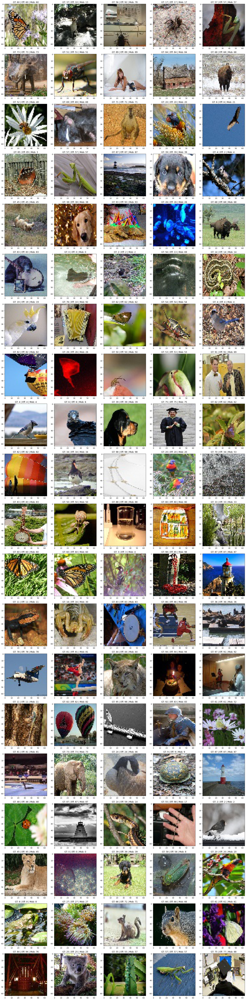

In [ ]:
# Plot classified images with labels
fig = plt.subplots(20,5, figsize = (20,80))
n = 1
i_lab = 0
# Indeces chosen randomly
for idx in indices:
  img = Image.open(f'/content/TinyImageNet/{data_test["Path"].iloc[idx]}')
  lab_true = data_test["Label"].iloc[idx]
  lab_eff = labels_eff[i_lab]
  lab_mob = labels_mob[i_lab]

  plt.subplot(20,5,n)
  plt.imshow(img)
  plt.title(f'GT: {lab_true} | Eff: {lab_eff} | Mob: {lab_mob}')

  n+=1
  i_lab+=1

plt.tight_layout()
plt.show()

# Part 4. Grad-CAM

Use the Grad-CAM function for explanability of the models

In [7]:
#Install the grad-cam library
!pip install grad-cam -q
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image, \
    deprocess_image, \
    preprocess_image

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 62.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [10]:
# import the trained models (set load_model = True)
load_model = True

if load_model:
  # Load mobile net
  net_mob = torchvision.models.mobilenet_v3_large()
  # Redefine the same architecure
  num_features = net_mob.classifier[0].in_features

  net_mob.classifier = nn.Sequential(nn.Linear(num_features, 704),
                                    nn.ReLU(),
                                    nn.Linear(704, 352),
                                    nn.ReLU(),
                                    nn.Linear(352, 100))

  !gdown -q '1XFmUUUtOou3q2kTjXMwKE2bLOEvjtHpf'
  checkpoint = torch.load("/content/mobile_net_large_2_best.pth", map_location = device)
  net_mob.load_state_dict(checkpoint['model'])
  net_mob.eval()

  # Load Efficent net
  net_eff = torchvision.models.efficientnet_b0()
  # Redefine the classifier
  num_features = net_eff.classifier[1].in_features
  net_eff.classifier = nn.Sequential(nn.Linear(num_features, 704),
                                      nn.ReLU(),
                                      nn.Linear(704, 352),
                                      nn.ReLU(),
                                      nn.Linear(352, 100))

  !gdown -q '1ffl7tDE_T2AtWlZOaRWUWRi0_l5RGLwH'
  checkpoint = torch.load("/content/Efficent_net_b0_2_best.pth", map_location = device)
  net_eff.load_state_dict(checkpoint['model'])
  net_eff.eval()

In [11]:
# Dataset for the grad_cam function
# Returns: image = image resized to 224x224 and scaled with values between 0 and 1
#           input_temsor = transform the image as the input of the networks
class GradCamDataset(Dataset):
  def __init__(self, df_root):
    """
      root_dir (string): Directory with all the images.
      transform (callable, optional): Optional transform to be applied on a sample.
    """
    self.root = df_root
    self.resize = transforms.Compose([transforms.Resize((256,256), interpolation=InterpolationMode.BICUBIC),
                                      transforms.CenterCrop((224,224)),
                                      ])
    self.normalize = transforms.Compose([transforms.ToTensor(),
                                        transforms.Normalize(
                                          mean=[0.485, 0.456, 0.406],
                                          std=[0.229, 0.224, 0.225])
                                         ])
  def __len__(self):
    return len(self.root)

  def __getitem__(self, idx):
    img_name = self.root["Path"][idx]
    img_label = self.root["Label"][idx]
    image = Image.open(f'/content/TinyImageNet/{img_name}')
    # image
    image = self.resize(image)
    image = np.float32(image) / 255
    #input of the network
    input_tensor = self.normalize(image)

    return image, input_tensor

In [20]:
# l = label of the class to investigate
l = 53

# Dataset with only the image with the label of interest
gradset = GradCamDataset(data_test.loc[data_test['Label'] == l].reset_index())

gradloader = torch.utils.data.DataLoader(gradset, batch_size= 1,
                                         shuffle=False, num_workers=0)

In [21]:
# Target class
targets = [ClassifierOutputTarget(l)]
# Layer where to extract the features (last convolutional layer)
target_layers_mob = [net_mob.features[16]]
target_layers_eff = [net_eff.features[8]]

# List of the original images
orig_image = []
# List of the heat map of the efficient net
cam_image_eff = []
# List of the heat map of the mobile net
cam_image_mob = []
for image, input_tensor in gradloader:

    orig_image.append(np.array(image.squeeze(0)))
    # Efficent net
    with GradCAM(model=net_eff, target_layers=target_layers_eff) as cam:
      # Compute the grad-cam
      grayscale_cams_eff = cam(input_tensor=input_tensor, targets=targets)
      # compute the heat map
      cam_image_eff.append((show_cam_on_image(np.array(image), grayscale_cams_eff[0, :], use_rgb=True)).squeeze(0))

    # Mobile net
    with GradCAM(model=net_mob, target_layers=target_layers_mob) as cam:
      # compute the grad-cam
      grayscale_cams_mob = cam(input_tensor=input_tensor, targets=targets)
      # compute the heat map
      cam_image_mob.append((show_cam_on_image(np.array(image), grayscale_cams_mob[0, :], use_rgb=True)).squeeze(0))

In [22]:
orig_image[0].shape

(224, 224, 3)

In [23]:
# Efficent Net
# Show the firsts 10 images and heat map
n_img = 10
fig, axs = plt.subplots(n_img, figsize = (20, 40))
for i in range(n_img):
  images = np.hstack((np.uint8(255*np.array(orig_image)[i]), cam_image_eff[i]))
  axs[i].imshow(Image.fromarray(images))
  axs[i].axis('off')

Output hidden; open in https://colab.research.google.com to view.

In [24]:
# Mobile Net
# Show the firsts 10 images and heat map
n_img = 10
fig, axs = plt.subplots(n_img, figsize = (20, 40))
for i in range(n_img):
  images = np.hstack((np.uint8(255*np.array(orig_image)[i]), cam_image_mob[i]))
  axs[i].imshow(Image.fromarray(images))
  axs[i].axis('off')

Output hidden; open in https://colab.research.google.com to view.